# Loading BOA from JSON and Plotting Results

This notebook demonstrates how to:

Loading a Scheduler from JSON from a previous run (If you want to see the Experiment that this is from, see :ref:`Running BOA Optimization Directly in Python`). We will look at the output and plot some exploratory data analysis.

In [2]:
import sys

import pathlib

from ax.utils.notebook.plotting import init_notebook_plotting, render
from ax.plot.trace import optimization_trace_single_method_plotly
from ax.service.utils.report_utils import get_standard_plots, exp_to_df
from ax.utils.measurement.synthetic_functions import hartmann6
import boa
from botorch.test_functions.synthetic import Cosine8

init_notebook_plotting()

[INFO 11-04 22:52:48] ax.utils.notebook.plotting: Injecting Plotly library into cell. Do not overwrite or delete cell.


## Loading the Scheduler

In [9]:
# Filepath to the scheduler.json
scheduler_fp = ...  # enter your file path here

In [28]:
scheduler = boa.scheduler_from_json_file(scheduler_fp)
experiment = scheduler.experiment

[WARNING 11-03 10:31:49] Scheduler: Experiment(boa_runs) already has 100 trials associated with it. Total trials setting for this scheduler is 100, so no more trials would be run in this scheduler if `Scheduler.run_all_trials` is called (but you can still use `Scheduler.run_n_trials` to run a fixed number of trials).


## Get the Best Trial and Output All Trials

In [29]:
best_trial, best_params, obj = scheduler.get_best_trial()
best_trial

99

In [30]:
exp_to_df(experiment)

,Cosine8,trial_index,arm_name,x0,x1,x2,x3,x4,x5,x6,x7,trial_status,generation_method
0,2.455147,0,0_0,0.006323,0.679710,0.892626,0.045788,0.725623,0.700916,0.491610,0.221115,COMPLETED,Sobol
3,2.721022,1,1_0,0.233644,0.179138,0.725891,0.761201,0.268760,0.491644,0.974299,0.140603,COMPLETED,Sobol
15,3.889800,2,2_0,0.100613,0.399377,0.931825,0.679564,0.220618,0.986822,0.806515,0.847009,COMPLETED,Sobol
27,4.530968,3,3_0,0.794928,0.706348,0.708870,0.848115,0.491325,0.982564,0.713169,0.828831,COMPLETED,Sobol
39,2.435885,4,4_0,0.241936,0.258708,0.618985,0.340174,0.882727,0.397070,0.393161,0.888107,COMPLETED,Sobol
...,...,...,...,...,...,...,...,...,...,...,...,...,...
94,1.359417,95,95_0,0.710519,0.222123,0.027711,0.063800,0.709602,0.417693,0.003198,0.562925,COMPLETED,GPEI
95,-0.637411,96,96_0,0.032024,0.000000,0.000000,0.379561,0.000000,0.000000,0.000000,0.000000,COMPLETED,GPEI
96,4.646904,97,97_0,0.969561,0.577894,0.182470,0.977702,0.607902,0.571084,0.914322,0.506858,COMPLETED,GPEI
97,1.919691,98,98_0,0.012235,0.815254,0.023143,0.859369,0.127421,0.741572,0.561837,0.038080,COMPLETED,GPEI


## EDA Plots

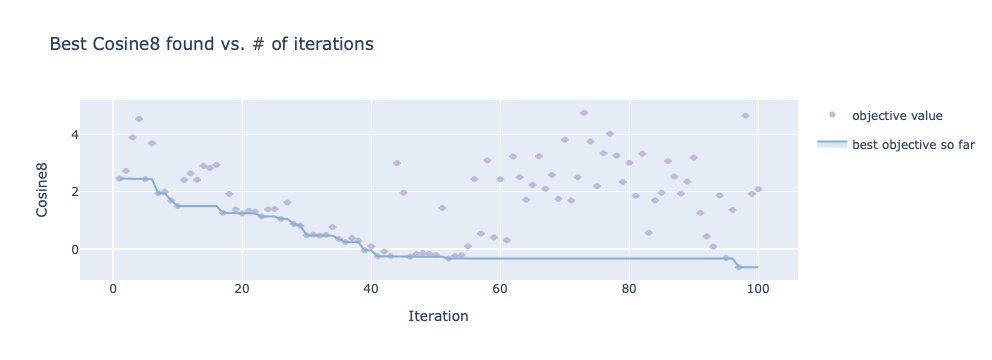

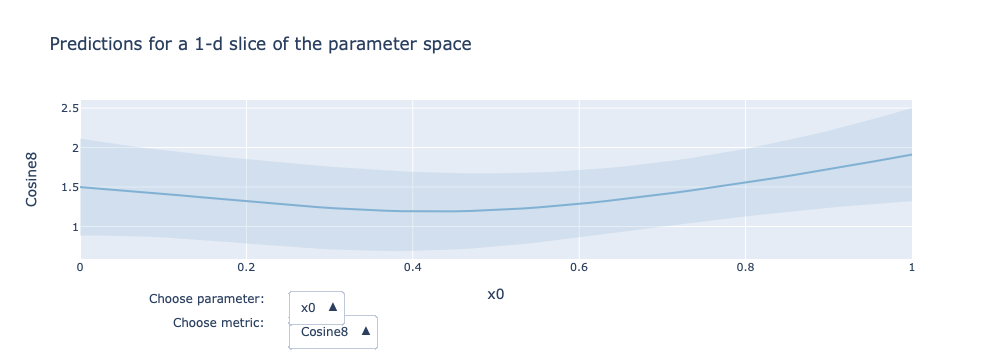

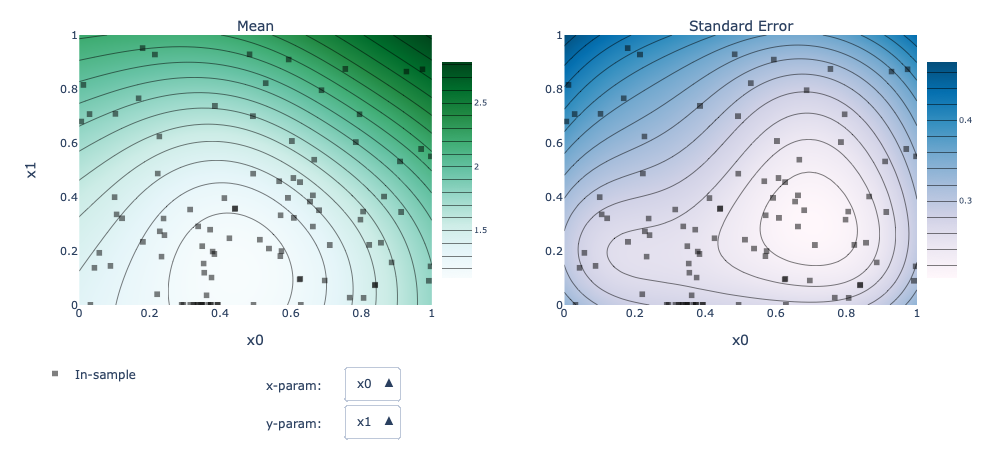

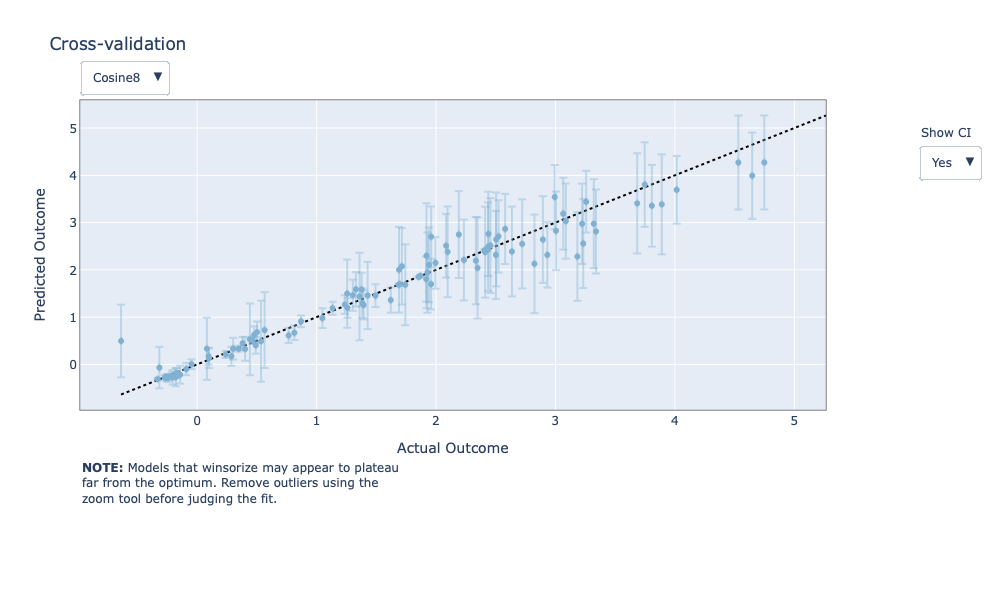

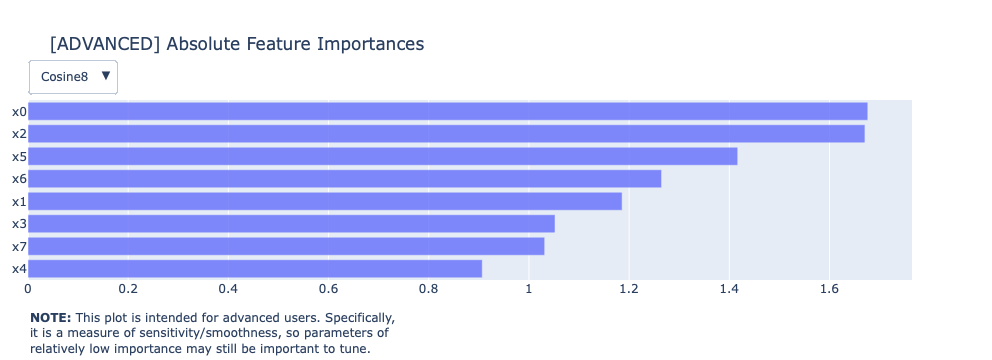

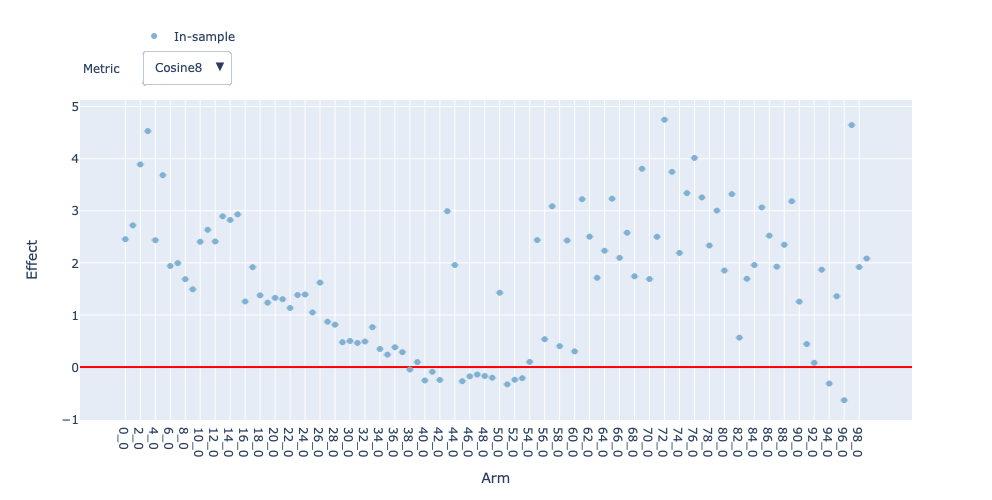

In [31]:
plots = get_standard_plots(experiment, scheduler.generation_strategy.model)
for plot in plots:
    plot.show()

In [39]:
optimum = -Cosine8().optimal_value

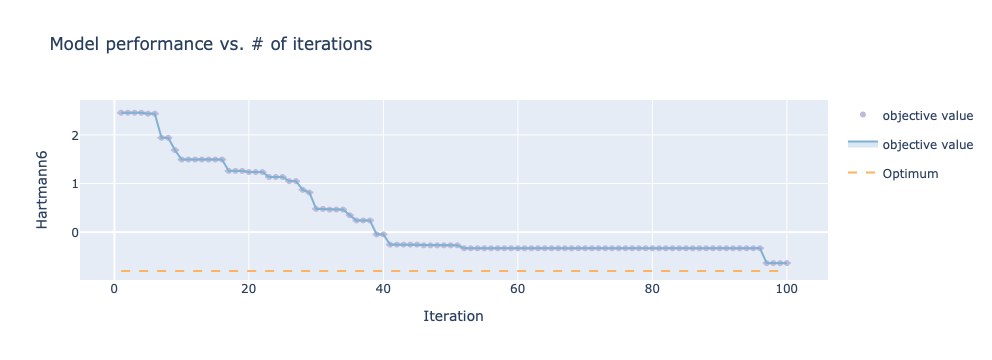

In [40]:
import numpy as np
# `plot_single_method` expects a 2-d array of means, because it expects to average means from multiple 
# optimization runs, so we wrap out best objectives array in another array.
best_objectives = np.array([[trial.objective_mean for trial in experiment.trials.values()]])
optimization_trace_single_method_plotly(
    y=np.minimum.accumulate(best_objectives, axis=1),
    optimum=optimum,
    title="Model performance vs. # of iterations",
    ylabel="Hartmann6",
    plot_trial_points=True
)

In [41]:
optimization_config = experiment.optimization_config

In [42]:
scheduler.generation_strategy.model_transitions

[16]

In [43]:
[
        metric_name
        for metric_name in [
            optimization_config.objective.metric.name,

        ]
        if metric_name is not None
]

['Cosine8']

In [44]:
model_transitions = scheduler.generation_strategy.model_transitions

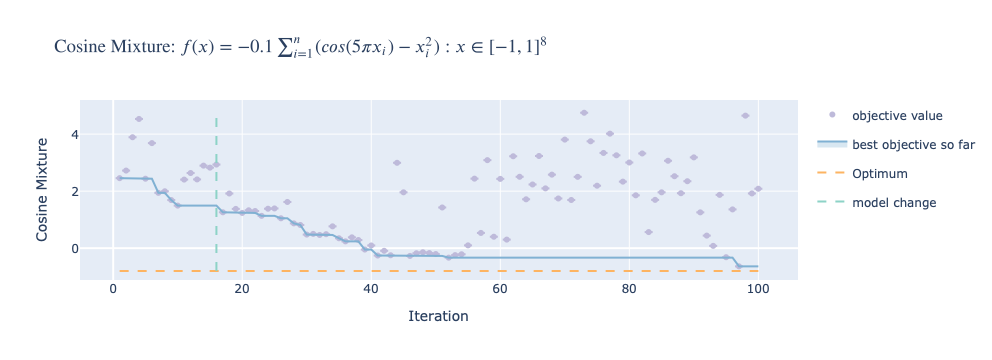

In [48]:
data = experiment.fetch_data()
metric_name = "Cosine8"
optimization_trace_single_method_plotly(
            y=np.array([data.df[data.df["metric_name"] == metric_name]["mean"]]),
            title=r"$\text{ Cosine Mixture: } f(x) = -0.1 \sum_{i=1}^n (cos(5 \pi x_i) - x_i^2) : x \in [-1, 1]^8$",
            ylabel="Cosine Mixture",
            model_transitions=model_transitions,
            # Try and use the metric's lower_is_better property, but fall back on
            # objective's minimize property if relevent
            optimum=optimum,
            optimization_direction=(
                (
                    "minimize"
                    if experiment.metrics[metric_name].lower_is_better is True
                    else "maximize"
                )
                if experiment.metrics[metric_name].lower_is_better is not None
                else (
                    "minimize" if optimization_config.objective.minimize else "maximize"
                )
            ),
            plot_trial_points=True,
        )

In [46]:
optimum

-0.8